In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
# pd.set_option('max_colwidth', 50)
# set this if you need to

The Health Department has developed an inspection report and scoring system. 
After conducting an inspection of the facility, the Health Inspector calculates a score based on the violations observed. 
Violations can fall into:
- **high risk category**: records specific violations that directly relate to the transmission of food borne illnesses,the adulteration of food products and the contamination of food-contact surfaces.
- **moderate risk category**: records specific violations that are of a moderate risk to the public health and safety.
- **low risk category**: records violations that are low risk or have no immediate risk to the public health and safety.

In [4]:
businesses = pd.read_csv('./data/businesses_plus.csv', parse_dates=True, dtype={'phone_number': str})
businesses.head(142)
# dtype casts the column as a specific data type


,business_id,name,address,city,postal_code,latitude,longitude,phone_number,TaxCode,business_certificate,application_date,owner_name,owner_address,owner_city,owner_state,owner_zip
0,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,NaN,Tiramisu LLC,33 Belden St,San Francisco,CA,94104
1,19,Nrgize Lifestyle Cafe,"1200 Van Ness Ave, 3rd Floor",San Francisco,94109,37.786848,-122.421547,NaN,H24,NaN,NaN,24 Hour Fitness Inc,"1200 Van Ness Ave, 3rd Floor",San Francisco,CA,94109
2,24,OMNI S.F. Hotel - 2nd Floor Pantry,"500 California St, 2nd Floor",San Francisco,94104,37.792888,-122.403135,NaN,H24,352312.0,NaN,OMNI San Francisco Hotel Corp,"500 California St, 2nd Floor",San Francisco,CA,94104
3,31,Norman's Ice Cream and Freezes,2801 Leavenworth St,San Francisco,94133,37.807155,-122.419004,NaN,H24,346882.0,NaN,Norman Antiforda,2801 Leavenworth St,San Francisco,CA,94133
4,45,CHARLIE'S DELI CAFE,3202 FOLSOM St,S.F.,94110,37.747114,-122.413641,NaN,H24,340024.0,10/10/2001,"HARB, CHARLES AND KRISTIN",1150 SANCHEZ,S.F.,CA,94114
5,48,ART'S CAFE,747 IRVING St,SAN FRANCISCO,94122,37.764013,-122.465749,NaN,H24,318022.0,NaN,YOON HAE RYONG,1567 FUNSTON AVE,SAN FRANCISCO,CA,94122
6,50,SUSHI ZONE,1815 Market St.,SF,94103,37.771437,-122.423892,+14155621114,H24,NaN,NaN,"AOYAMA, KIMIAKI",246 Ney Vst,SF,CA,94112
7,54,RHODA GOLDMAN PLAZA,2180 POST St,S.F.,94115,37.784626,-122.437734,+14155345060,H24,417778.0,NaN,RHODA GOLDMAN PLAZA,2180 POST St,S.F.,CA,94115
8,56,CAFE X + O,1799 Church St,SF,94131,37.742325,-122.426476,+14155823535,H24,347603.0,NaN,"BOUSIAKIS, ADAM",1799 CHURCH,SF,CA,94131
9,58,Oasis Grill,91 Drumm St,San Francisco,94111,37.794483,-122.396584,NaN,H24,954377.0,NaN,Mohammad Zughaiyir,91 Drumm St,San Francisco,CA,94111


In [5]:
inspections = pd.read_csv('./data/inspections_plus.csv', parse_dates=True)
inspections.tail(5)

,business_id,Score,date,type
27280,86990,NaN,20160318,New Ownership
27281,87021,NaN,20160331,New Construction
27282,87121,NaN,20160330,New Ownership
27283,87122,NaN,20160401,New Ownership
27284,87122,100.0,20160401,Routine - Unscheduled


In [145]:
violations = pd.read_csv('./data/violations_plus.csv', parse_dates=True)
violations.head()

,business_id,date,ViolationTypeID,risk_category,description
0,10,20140114,103154,Low Risk,Unclean or degraded floors walls or ceilings
1,10,20140114,103119,Moderate Risk,Inadequate and inaccessible handwashing facili...
2,10,20140114,103145,Low Risk,Improper storage of equipment utensils or linens
3,10,20140729,103129,Moderate Risk,Insufficient hot water or running water
4,10,20140729,103144,Low Risk,Unapproved or unmaintained equipment or utensils


In [147]:
# 1 Combine the three dataframes into one data frame called restaurant_scores
# Hint: http://pandas.pydata.org/pandas-docs/stable/merging.html

restaurant_scores_a = pd.merge(businesses, inspections, how='inner', left_on='business_id', right_on='business_id')
restaurant_scores = pd.merge(restaurant_scores_a, violations, how='inner', left_on='business_id', right_on='business_id')
restaurant_scores


# this is data wrangling


,business_id,name,address,city,postal_code,latitude,longitude,phone_number,TaxCode,business_certificate,...,owner_city,owner_state,owner_zip,Score,date_x,type,date_y,ViolationTypeID,risk_category,description
0,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,NaN,20140807,Reinspection/Followup,20140114,103154,Low Risk,Unclean or degraded floors walls or ceilings
1,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,NaN,20140807,Reinspection/Followup,20140114,103119,Moderate Risk,Inadequate and inaccessible handwashing facili...
2,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,NaN,20140807,Reinspection/Followup,20140114,103145,Low Risk,Improper storage of equipment utensils or linens
3,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,NaN,20140807,Reinspection/Followup,20140729,103129,Moderate Risk,Insufficient hot water or running water
4,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,NaN,20140807,Reinspection/Followup,20140729,103144,Low Risk,Unapproved or unmaintained equipment or utensils
5,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,94.0,20140729,Routine - Unscheduled,20140114,103154,Low Risk,Unclean or degraded floors walls or ceilings
6,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,94.0,20140729,Routine - Unscheduled,20140114,103119,Moderate Risk,Inadequate and inaccessible handwashing facili...
7,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,94.0,20140729,Routine - Unscheduled,20140114,103145,Low Risk,Improper storage of equipment utensils or linens
8,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,94.0,20140729,Routine - Unscheduled,20140729,103129,Moderate Risk,Insufficient hot water or running water
9,10,Tiramisu Kitchen,033 Belden Pl,San Francisco,94104,37.791116,-122.403816,NaN,H24,779059.0,...,San Francisco,CA,94104,94.0,20140729,Routine - Unscheduled,20140729,103144,Low Risk,Unapproved or unmaintained equipment or utensils


In [161]:
inspections.business_id.value_counts().head(10)

1775     21
74374    20
2505     20
71618    19
74131    19
67154    19
71804    19
489      18
7747     18
65523    17
Name: business_id, dtype: int64

In [163]:
# 2 Which ten business have had the most inspections?
# infected_eateries_id = restaurant_scores['business_id'].value_counts()
# infected_eateries_name = restaurant_scores['name'].value_counts()
# # infected_eateries = pd.merge(infected_eateries_id, infected_eateries_name)
# print infected_eateries_id.head(10)
# print infected_eateries_name.head(10)

top_inspected = list(inspections.business_id.value_counts().head(10).index)

top_inspected

businesses[businesses.business_id.isin(top_inspected)].name

141                 Dol-Ho Restaurant
463                        Sapporo-Ya
679        AMERICANA GRILL & FOUNTAIN
2345               SAFEWAY STORE #964
4132                      Chez Fayala
4349     RIVERSIDE SEAFOOD RESTAURANT
5123                           Rustic
5154                        La Urbana
5252    Deena's Market and Smoke Shop
5289    Gallardo's Mexican Restaurant
Name: name, dtype: object

In [31]:
# 3 Group and count the inspections by type

# top_violations = list(restaurant_scores.ViolationTypeID.value_counts().head(10).index)
# top_violations

restaurant_scores.groupby(pd.Grouper(key='ViolationTypeID')).count().name.plot()


# do another value count on the type category like i did for business ids

In [6]:
# 4 Create a plot that shows number of inspections per month

# I will need to change all dates from floats to dates

# inspections.date = inspections.date.apply(lambda x: pd.to_datetime(str(x), format='%Y%m%d'))

# inspections.date = [pd.to_datetime(str(x), format = '%Y%m%d') for x in inspections.date]

inspections.date.head()

# Bonus for creating a heatmap
# http://stanford.edu/~mwaskom/software/seaborn/generated/seaborn.heatmap.html?highlight=heatmap

0    20140807
1    20140729
2    20140124
3    20140114
4    20141110
Name: date, dtype: int64

In [326]:
# 5 Which zip code contains the most high risk violations?
#

restaurant_scores['postal_code'].value_counts().head(1)

94110    25534
Name: postal_code, dtype: int64

In [346]:
# 6 If inspection is prompted by a change in restaurant ownership, 
# is the inspection more likely to be categorized as higher or lower risk?

# new_ownership = list(restaurant_scores if 'type' == 'New Ownership')

restaurant_scores[['type', 'risk_category']][restaurant_scores.type == 'New Ownership'].sum().value_counts().plot(kind='bar')
        
    

In [327]:
# 7 Examining the descriptions, what is the most common violation?
restaurant_scores['description'].value_counts().head(1)

Unclean or degraded floors walls or ceilings    20839
Name: description, dtype: int64

In [1]:
# 8 Create a hist of the scores with 10 bins
##restaurant_scores.hist(10)

In [ ]:
# 9 Can you predict risk category based on the other features in this dataset?

In [ ]:
# 10 Extra Credit:
# Use Instagram location API to find pictures taken at the lat, long of the most High Risk restaurant
# https://www.instagram.com/developer/endpoints/locations/

In [ ]:
############################
### A Little More Morbid ###
############################

In [180]:
killings = pd.read_csv('./data/police-killings.csv')
killings.head()

,Unnamed: 0,name,age,gender,raceethnicity,month,day,year,streetaddress,city,state,lawenforcementagency,cause,armed,county_income
0,0,A'donte Washington,16,Male,Black,February,23,2015,Clearview Ln,Millbrook,AL,Millbrook Police Department,Gunshot,No,54766
1,1,Aaron Rutledge,27,Male,White,April,2,2015,300 block Iris Park Dr,Pineville,LA,Rapides Parish Sheriff's Office,Gunshot,No,40930
2,2,Aaron Siler,26,Male,White,March,14,2015,22nd Ave and 56th St,Kenosha,WI,Kenosha Police Department,Gunshot,No,54930
3,3,Aaron Valdez,25,Male,Hispanic/Latino,March,11,2015,3000 Seminole Ave,South Gate,CA,South Gate Police Department,Gunshot,Firearm,55909
4,4,Adam Jovicic,29,Male,White,March,19,2015,364 Hiwood Ave,Munroe Falls,OH,Kent Police Department,Gunshot,No,49669


In [181]:
# 1. Make the following changed to column names:
# lawenforcementagency -> agency
# raceethnicity        -> race
killings.rename(columns={'raceethnicity':'race', 'lawenforcementagency': 'agency'}, inplace=True)
killings.head()

,Unnamed: 0,name,age,gender,race,month,day,year,streetaddress,city,state,agency,cause,armed,county_income
0,0,A'donte Washington,16,Male,Black,February,23,2015,Clearview Ln,Millbrook,AL,Millbrook Police Department,Gunshot,No,54766
1,1,Aaron Rutledge,27,Male,White,April,2,2015,300 block Iris Park Dr,Pineville,LA,Rapides Parish Sheriff's Office,Gunshot,No,40930
2,2,Aaron Siler,26,Male,White,March,14,2015,22nd Ave and 56th St,Kenosha,WI,Kenosha Police Department,Gunshot,No,54930
3,3,Aaron Valdez,25,Male,Hispanic/Latino,March,11,2015,3000 Seminole Ave,South Gate,CA,South Gate Police Department,Gunshot,Firearm,55909
4,4,Adam Jovicic,29,Male,White,March,19,2015,364 Hiwood Ave,Munroe Falls,OH,Kent Police Department,Gunshot,No,49669


In [182]:
# 2. Show the count of missing values in each column
# killings.isnull().sum()
null_data = killings[killings.isnull().any(axis=1)]
null_data


,Unnamed: 0,name,age,gender,race,month,day,year,streetaddress,city,state,agency,cause,armed,county_income
50,50,Billy Patrick,29,Male,White,April,26,2015,NaN,Bunch,OK,Oklahoma Department of Wildlife Conservation,Gunshot,Firearm,32556
280,280,Kenneth Brown,18,Male,White,January,4,2015,NaN,Guthrie,OK,Oklahoma State Police,Gunshot,Non-lethal firearm,53591
379,379,Ricky Hall,27,Male,Black,March,30,2015,NaN,Fort Meade,MD,NSA Police Department,Gunshot,Firearm,87430
405,405,Santos 'Cuate' Cortez Hernandez,24,Male,Hispanic/Latino,April,20,2015,NaN,Mission,TX,Hidalgo County Sheriff's Office,Gunshot,Firearm,34146


In [177]:
# 3. replace each null value in the dataframe with the string "Unknown"
# killings = ['Unknown' if v is None else v for v in killings]

In [183]:
killings.fillna('Unknown', inplace = True)

In [184]:
killings.isnull().sum()

Unnamed: 0       0
name             0
age              0
gender           0
race             0
month            0
day              0
year             0
streetaddress    0
city             0
state            0
agency           0
cause            0
armed            0
county_income    0
dtype: int64

In [193]:
# 4. How many killings were there so far in 2015?
killings.shape[0]

467

In [83]:
# 5. Of all killings, how many were male and how many female?
killings['gender'].value_counts()


Male      445
Female     22
Name: gender, dtype: int64

In [86]:
# 6. How many killings were of unarmed people?
unarmed = killings['armed'].value_counts()
unarmed


Firearm               230
No                    102
Knife                  68
Other                  26
Vehicle                18
Non-lethal firearm     14
Unknown                 7
Disputed                2
Name: armed, dtype: int64

In [194]:
# 7. What percentage of all killings were unarmed?
killings.armed[killings.armed =='No'].value_counts()/killings.shape[0]


No    0.218415
Name: armed, dtype: float64

In [91]:
# 8. What are the 5 states with the most killings?
killings['state'].value_counts().head()


CA    74
TX    46
FL    29
AZ    25
OK    22
Name: state, dtype: int64

In [92]:
# 9. Show a value counts of deaths for each race
killings['race'].value_counts()


White                     236
Black                     135
Hispanic/Latino            67
Unknown                    15
Asian/Pacific Islander     10
Native American             4
Name: race, dtype: int64

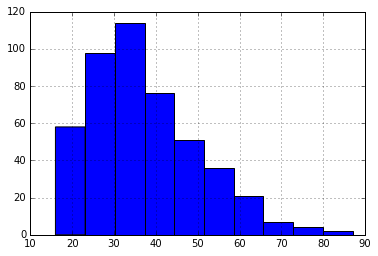

In [210]:
# 10. Display a histogram of ages of all killings
# df = pd.DataFrame(killings)



killings['age'].hist()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x12c591490>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x12c8ddf10>]], dtype=object)

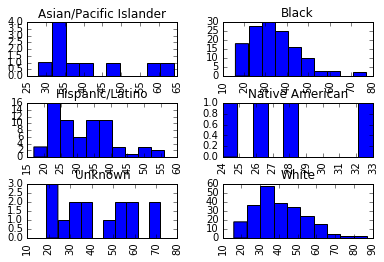

In [216]:
# 11. Show 6 histograms of ages by race
killings['age'].hist(by= killings['race'])

In [228]:
# 12. What is the average age of death by race?
killings.groupby('race').age.mean()

race
Asian/Pacific Islander    40.800000
Black                     34.044444
Hispanic/Latino           31.716418
Native American           27.750000
Unknown                   43.533333
White                     40.466102
Name: age, dtype: float64

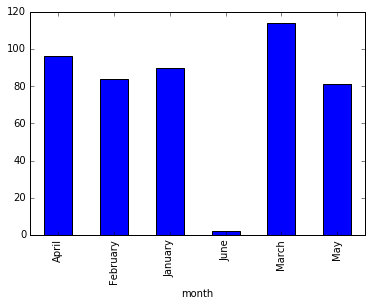

In [297]:
# 13. Show a bar chart with counts of deaths every month
killings.groupby('month').size().plot(kind='bar')
# majors.groupby('Major').Median.mean().head(10).sort_values().plot(kind='bar')

In [ ]:
###################
### Less Morbid ###
###################

In [253]:
majors = pd.read_csv('./data/college-majors.csv')
majors.head()

,Unnamed: 0,Major_code,Major,Major_category,Total,Employed,Employed_full_time_year_round,Unemployed,Unemployment_rate,Median,P25th,P75th
0,0,1100,GENERAL AGRICULTURE,Agriculture & Natural Resources,128148,90245,74078,2423,0.026147,50000,34000,80000.0
1,1,1101,AGRICULTURE PRODUCTION AND MANAGEMENT,Agriculture & Natural Resources,95326,76865,64240,2266,0.028636,54000,36000,80000.0
2,2,1102,AGRICULTURAL ECONOMICS,Agriculture & Natural Resources,33955,26321,22810,821,0.030248,63000,40000,98000.0
3,3,1103,ANIMAL SCIENCES,Agriculture & Natural Resources,103549,81177,64937,3619,0.042679,46000,30000,72000.0
4,4,1104,FOOD SCIENCE,Agriculture & Natural Resources,24280,17281,12722,894,0.049188,62000,38500,90000.0


In [112]:
# 1. Delete the columns (employed_full_time_year_round, major_code)
del majors['Employed_full_time_year_round']
del majors['Major_code']
majors.head()


,Unnamed: 0,Major,Major_category,Total,Employed,Unemployed,Unemployment_rate,Median,P25th,P75th
0,0,GENERAL AGRICULTURE,Agriculture & Natural Resources,128148,90245,2423,0.026147,50000,34000,80000.0
1,1,AGRICULTURE PRODUCTION AND MANAGEMENT,Agriculture & Natural Resources,95326,76865,2266,0.028636,54000,36000,80000.0
2,2,AGRICULTURAL ECONOMICS,Agriculture & Natural Resources,33955,26321,821,0.030248,63000,40000,98000.0
3,3,ANIMAL SCIENCES,Agriculture & Natural Resources,103549,81177,3619,0.042679,46000,30000,72000.0
4,4,FOOD SCIENCE,Agriculture & Natural Resources,24280,17281,894,0.049188,62000,38500,90000.0


In [113]:
# 2. Show the cout of missing values in each column
null_data = majors[majors.isnull().any(axis=1)]
null_data


,Unnamed: 0,Major,Major_category,Total,Employed,Unemployed,Unemployment_rate,Median,P25th,P75th


In [123]:
# 3. What are the top 10 highest paying majors?

top_inspected = list(majors.Median.value_counts().head(10).index)
top_inspected
top_majors = majors[majors.Median.isin(top_inspected)].Major.head(10)
top_majors


0                  GENERAL AGRICULTURE
2               AGRICULTURAL ECONOMICS
4                         FOOD SCIENCE
5           PLANT SCIENCE AND AGRONOMY
6                         SOIL SCIENCE
11                        ARCHITECTURE
13                      COMMUNICATIONS
14                          JOURNALISM
15                          MASS MEDIA
16    ADVERTISING AND PUBLIC RELATIONS
Name: Major, dtype: object

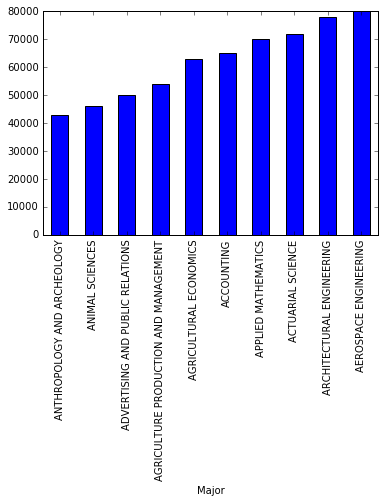

In [240]:
# 4. Plot the data from the last question in a bar chart, include proper title, and labels!
majors.groupby('Major').Median.mean().head(10).sort_values().plot(kind='bar')

In [242]:
# 5. What is the average median salary for each major category?

majors.groupby('Major').Median.mean()


Major
ACCOUNTING                                       65000
ACTUARIAL SCIENCE                                72000
ADVERTISING AND PUBLIC RELATIONS                 50000
AEROSPACE ENGINEERING                            80000
AGRICULTURAL ECONOMICS                           63000
AGRICULTURE PRODUCTION AND MANAGEMENT            54000
ANIMAL SCIENCES                                  46000
ANTHROPOLOGY AND ARCHEOLOGY                      43000
APPLIED MATHEMATICS                              70000
ARCHITECTURAL ENGINEERING                        78000
ARCHITECTURE                                     63000
AREA ETHNIC AND CIVILIZATION STUDIES             46000
ART AND MUSIC EDUCATION                          42600
ART HISTORY AND CRITICISM                        44500
ASTRONOMY AND ASTROPHYSICS                       80000
ATMOSPHERIC SCIENCES AND METEOROLOGY             60000
BIOCHEMICAL SCIENCES                             53000
BIOLOGICAL ENGINEERING                           62000
BIOL

In [252]:
# 6. Show only the top 5 paying major categories

majors.groupby('Major').Median.mean().head()


Major
ACCOUNTING                          65000
ACTUARIAL SCIENCE                   72000
ADVERTISING AND PUBLIC RELATIONS    50000
AEROSPACE ENGINEERING               80000
AGRICULTURAL ECONOMICS              63000
Name: Median, dtype: int64

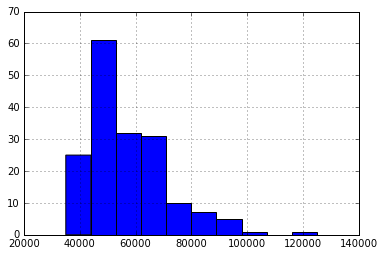

In [251]:
# 7. Plot a histogram of the distribution of median salaries

majors['Median'].hist()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x187264d90>,
        <matplotlib.axes._subplots.AxesSubplot object at 0x189324bd0>]], dtype=object)

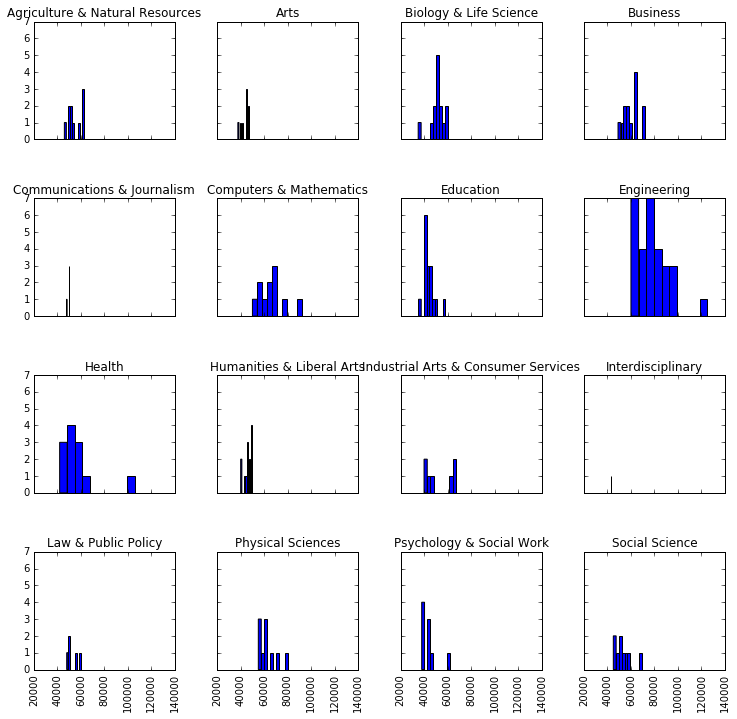

In [272]:
# 8. Plot a histogram of the distribution of median salaries by major category
majors['Median'].hist(by=majors['Major_category'],sharey= True, sharex= True, figsize=(12,12))


In [284]:
# 9. What are the top 10 most UNemployed majors?
# majors.groupby('Major').Median.mean(majors('Unemployed')).head(10)
majors[['Major','Unemployed']].sort_values(by='Unemployed',ascending=False).head(10)

,Major,Unemployed
161,BUSINESS MANAGEMENT AND ADMINISTRATION,147261
158,GENERAL BUSINESS,85626
114,PSYCHOLOGY,79066
159,ACCOUNTING,75379
13,COMMUNICATIONS,54390
73,ENGLISH LANGUAGE AND LITERATURE,52248
164,MARKETING AND MARKETING RESEARCH,51839
132,POLITICAL SCIENCE AND GOVERNMENT,40376
25,GENERAL EDUCATION,38742
78,BIOLOGY,36757


In [298]:
# What are the unemployment rates?
majors[['Major','Unemployment_rate']].sort_values(by='Unemployment_rate',ascending=False).head(10)

,Major,Unemployment_rate
146,MISCELLANEOUS FINE ARTS,0.156147
116,CLINICAL PSYCHOLOGY,0.102712
93,MILITARY TECHNOLOGIES,0.101796
27,SCHOOL STUDENT COUNSELING,0.101746
77,LIBRARY SCIENCE,0.094843
141,VISUAL AND PERFORMING ARTS,0.094658
19,COMPUTER PROGRAMMING AND DATA PROCESSING,0.090264
119,SOCIAL PSYCHOLOGY,0.087336
104,ASTRONOMY AND ASTROPHYSICS,0.086022
11,ARCHITECTURE,0.085991


In [299]:
# 10. What are the top 10 most UNemployed majors CATEGORIES? Use the mean for each category
# What are the unemployment rates?

majors[['Major_category','Unemployed']].sort_values(by='Unemployed',ascending=False).head(10)

,Major_category,Unemployed
161,Business,147261
158,Business,85626
114,Psychology & Social Work,79066
159,Business,75379
13,Communications & Journalism,54390
73,Humanities & Liberal Arts,52248
164,Business,51839
132,Social Science,40376
25,Education,38742
78,Biology & Life Science,36757


In [300]:
majors[['Major_category','Unemployment_rate']].sort_values(by='Unemployment_rate',ascending=False).head(10)

,Major_category,Unemployment_rate
146,Arts,0.156147
116,Psychology & Social Work,0.102712
93,Industrial Arts & Consumer Services,0.101796
27,Education,0.101746
77,Education,0.094843
141,Arts,0.094658
19,Computers & Mathematics,0.090264
119,Psychology & Social Work,0.087336
104,Physical Sciences,0.086022
11,Engineering,0.085991


In [311]:
# 11. the total and employed column refer to the people that were surveyed.
# Create a new column showing the emlpoyment rate of the people surveyed for each major
# call it "sample_employment_rate"
# Example the first row has total: 128148 and employed: 90245. it's 
# sample_employment_rate should be 90245.0 / 128148.0 = .7042
sample_unemployment_rate = majors['Employed']/majors['Total']

In [ ]:
# 12. Create a "sample_unemployment_rate" column
# this column should be 1 - "sample_employment_rate"

In [319]:
majors['sample_employment_rate'] = sample_unemployment_rate
majors.drop('sample_umployment_rate', axis = 1)

,Unnamed: 0,Major_code,Major,Major_category,Total,Employed,Employed_full_time_year_round,Unemployed,Unemployment_rate,Median,P25th,P75th,sample_employment_rate
0,0,1100,GENERAL AGRICULTURE,Agriculture & Natural Resources,128148,90245,74078,2423,0.026147,50000,34000,80000.0,0.704225
1,1,1101,AGRICULTURE PRODUCTION AND MANAGEMENT,Agriculture & Natural Resources,95326,76865,64240,2266,0.028636,54000,36000,80000.0,0.806338
2,2,1102,AGRICULTURAL ECONOMICS,Agriculture & Natural Resources,33955,26321,22810,821,0.030248,63000,40000,98000.0,0.775173
3,3,1103,ANIMAL SCIENCES,Agriculture & Natural Resources,103549,81177,64937,3619,0.042679,46000,30000,72000.0,0.783948
4,4,1104,FOOD SCIENCE,Agriculture & Natural Resources,24280,17281,12722,894,0.049188,62000,38500,90000.0,0.711738
5,5,1105,PLANT SCIENCE AND AGRONOMY,Agriculture & Natural Resources,79409,63043,51077,2070,0.031791,50000,35000,75000.0,0.793902
6,6,1106,SOIL SCIENCE,Agriculture & Natural Resources,6586,4926,4042,264,0.050867,63000,39400,88000.0,0.747950
7,7,1199,MISCELLANEOUS AGRICULTURE,Agriculture & Natural Resources,8549,6392,5074,261,0.039230,52000,35000,75000.0,0.747690
8,8,1301,ENVIRONMENTAL SCIENCE,Biology & Life Science,106106,87602,65238,4736,0.051290,52000,38000,75000.0,0.825608
9,9,1302,FORESTRY,Agriculture & Natural Resources,69447,48228,39613,2144,0.042563,58000,40500,80000.0,0.694458


In [320]:
majors.head()

,Unnamed: 0,Major_code,Major,Major_category,Total,Employed,Employed_full_time_year_round,Unemployed,Unemployment_rate,Median,P25th,P75th,sample_employment_rate,sample_umployment_rate
0,0,1100,GENERAL AGRICULTURE,Agriculture & Natural Resources,128148,90245,74078,2423,0.026147,50000,34000,80000.0,0.704225,0.704225
1,1,1101,AGRICULTURE PRODUCTION AND MANAGEMENT,Agriculture & Natural Resources,95326,76865,64240,2266,0.028636,54000,36000,80000.0,0.806338,0.806338
2,2,1102,AGRICULTURAL ECONOMICS,Agriculture & Natural Resources,33955,26321,22810,821,0.030248,63000,40000,98000.0,0.775173,0.775173
3,3,1103,ANIMAL SCIENCES,Agriculture & Natural Resources,103549,81177,64937,3619,0.042679,46000,30000,72000.0,0.783948,0.783948
4,4,1104,FOOD SCIENCE,Agriculture & Natural Resources,24280,17281,12722,894,0.049188,62000,38500,90000.0,0.711738,0.711738
